In [1]:
import tensorflow as tf
import numpy as np
import pandas as pd
import math
import random
import os,sys
import time, datetime, pytz
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import torch, torchvision
from torch import nn
from torch import Tensor
from torch.utils.data import IterableDataset, DataLoader, Dataset, TensorDataset
from torchvision import transforms
import torch.optim as optim
from torchvision import models
import torch.nn.functional as F
import segmentation_models_pytorch as smp
import lightning as pl
from lightning.pytorch.callbacks import TQDMProgressBar
from lightning.pytorch.callbacks import RichProgressBar
from lightning.pytorch.callbacks.early_stopping import EarlyStopping
from lightning.pytorch.callbacks import ModelCheckpoint
from lightning.pytorch.loggers import WandbLogger
from torchmetrics.classification import BinaryCohenKappa, StatScores


2024-02-20 23:08:19.582731: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
import wandb
wandb.login()

wandb: Currently logged in as: layla-tadjpour (ce). Use `wandb login --relogin` to force relogin


True

In [3]:
%load_ext autoreload
%autoreload 2
module_path = os.path.abspath("..")
if module_path not in sys.path: sys.path.append(module_path)

In [4]:
from src.data import GoogleStorageReader, Tile
from src.utils import *
from src.model import CFWModel

In [5]:
try:
    # Disable all GPUS
    tf.config.set_visible_devices([], 'GPU')
    visible_devices = tf.config.get_visible_devices()
    for device in visible_devices:
        assert device.device_type != 'GPU'
except:
    # Invalid device or cannot modify virtual devices once initialized.
    pass

2024-02-20 23:08:35.745483: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-02-20 23:08:35.796788: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-02-20 23:08:35.798611: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

In [6]:
bucket_name = "gee_image_us_landsat8_ccap_band13_tile_size256"
bucket_name_for_processed_tiles = "processed_tiles_sz_256"

gs_handler = GoogleStorageReader(bucket_name) 
files = gs_handler.list_files()  
tfr_files_list = gs_handler.list_tfrecord_files()
mixer = gs_handler.get_json_file()
tile = Tile(bucket_name)
image_features_dict = tile.feature_dict()

processed_gs_handler = GoogleStorageReader(bucket_name_for_processed_tiles) 
processed_files = processed_gs_handler.list_files()  
processed_tfr_files_list = processed_gs_handler.list_tfrecord_files()

In [7]:
gen_list = list_gen(processed_tfr_files_list,len(tfr_files_list),image_features_dict);

2024-02-20 23:08:46.009203: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-02-20 23:08:46.116115: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-02-20 23:08:46.193385: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{n

2024-02-20 23:08:48.089461: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-02-20 23:08:48.164887: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{node Placeholder/_0}}]]
2024-02-20 23:08:48.238611: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype string and shape [1]
	 [[{{n

In [8]:
data_bands = tile.data_label_bands()
gen_data = chain_list_tf_npiter(*gen_list)
train_data, label_data = dict_gen_to_arr_arr(gen_data,data_bands)

In [9]:
norm_data = normalize_array(train_data)
del train_data

In [10]:
new_data, new_label  =  remove_mismatched_data_label_tiles(norm_data,label_data)

In [11]:
#test for the above func
assert norm_data.shape[0]- new_data.shape[0] == 34
correct_nuniq = np.array([np.unique(img).size for img in new_data[:,[2,1,0],:,:] ])
assert np.where(correct_nuniq < 709)[0].size == 0

In [12]:
del norm_data

In [13]:
#histogram of class ratios
# img_size = label_data.size
# label_data.sum()/label_data.size
# cls_ratio_arr = pd.Series(np.squeeze(label_data.sum(axis=(2,3))/label_data[0,0].size))
# cls_ratio_arr.plot.hist(bins=100, grid='on',title="histogram of pixels (class 1 to 0) ratio per image")
# imbalance_ratio=0.15
# cls_ratio_arr[cls_ratio_arr < imbalance_ratio].size / label_data.shape[0]

In [14]:
x_, x_test, y_, y_test = train_test_split(new_data, new_label,
                                                test_size=0.1, random_state=42)
x_train, x_val, y_train, y_val = train_test_split(x_,y_, 
                                                test_size=0.2, random_state=42)

In [15]:
x_train.shape, x_val.shape, x_test.shape, y_train.shape, y_val.shape, y_test.shape

((1331, 24, 256, 256),
 (333, 24, 256, 256),
 (185, 24, 256, 256),
 (1331, 1, 256, 256),
 (333, 1, 256, 256),
 (185, 1, 256, 256))

In [16]:
del new_data

In [17]:
xtrain = torch.Tensor(x_train) 
ytrain = torch.Tensor(y_train)

xval = torch.Tensor(x_val) 
yval = torch.Tensor(y_val)

xtest = torch.Tensor(x_test) 
ytest = torch.Tensor(y_test)

In [18]:
train_dataset = TensorDataset(xtrain,ytrain) 
val_dataset = TensorDataset(xval,yval) 
test_dataset = TensorDataset(xtest,ytest) 

In [19]:
batch_size = 32
n_cpu = os.cpu_count()
train_dataloader = DataLoader(train_dataset,batch_size=batch_size,shuffle=True, num_workers=n_cpu) 
val_dataloader = DataLoader(val_dataset,batch_size=batch_size,shuffle=True, num_workers=n_cpu) 
test_dataloader = DataLoader(test_dataset,batch_size=batch_size, shuffle= False, num_workers=n_cpu) 

In [21]:
num_in_channel = 24
max_epochs = 100
arch = "UNet"
encoder = "inceptionresnetv2"
lr = 1e-04
wd = 0.5
scheduler='stepLR'

model = CFWModel(arch, encoder, in_channels=num_in_channel, augmentation = False, 
                 out_classes=1,learning_rate=lr, weight_decay = wd)

early_stop = EarlyStopping(monitor="valid_loss", patience=10, mode="min")
checkpoint_callback = ModelCheckpoint(save_top_k=1, monitor="valid_kappa", mode="max")


In [22]:
wandb_logger = WandbLogger(project='cfw_segmentation',
                           name=f'usEastSouth_corrected_sz256_{arch}_{encoder}_min_diceLoss_adamW_lr{lr}_wd{wd}_scheduler{scheduler}_ep{max_epochs}',
                           log_model=True) 

In [23]:
trainer = pl.Trainer(
    gpus=1, logger=wandb_logger,
    max_epochs= max_epochs, callbacks=[RichProgressBar(), early_stop, checkpoint_callback],
    auto_lr_find=True
)

/home/layla/.local/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/accelerator_connector.py:466: LightningDeprecationWarning: Setting `Trainer(gpus=1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=1)` instead.
  rank_zero_deprecation(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


In [24]:
# result = trainer.tune(model,train_dataloaders=train_dataloader)
#result['lr_find'].plot(suggest=True);

In [25]:
trainer.fit( model, 
    train_dataloaders=train_dataloader, 
    val_dataloaders=val_dataloader,
)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


┏━━━┳━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┓
┃   ┃ Name    ┃ Type     ┃ Params ┃
┡━━━╇━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━┩
│ 0 │ model   │ Unet     │ 62.0 M │
│ 1 │ loss_fn │ DiceLoss │      0 │
└───┴─────────┴──────────┴────────┘

Trainable params: 62.0 M                                                                                           
Non-trainable params: 0                                                                                            
Total params: 62.0 M                                                                                               
Total estimated model params size (MB): 248

Output()

/home/layla/.local/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:488: 
PossibleUserWarning: Your `val_dataloader`'s sampler has shuffling enabled, it is strongly recommended that you 
turn shuffling off for val/test/predict dataloaders.
  rank_zero_warn(

/home/layla/.local/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/logger_connector/result.py:232
: UserWarning: You called `self.log('step', ...)` in your `validation_epoch_end` but the value needs to be floating
point. Converting it to torch.float32.
  warning_cache.warn(

/home/layla/.local/lib/python3.10/site-packages/lightning/pytorch/trainer/trainer.py:1609: PossibleUserWarning: The
number of training batches (42) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower 
value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(

/home/layla/.local/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/logger_connector/result.py:232
: UserWarning: You called `self.log('step', ...)` in your `training_epoch_end` but the value needs to be floating 
point. Converting it to torch.float32.
  warning_cache.warn(

`Trainer.fit` stopped: `max_epochs=1` reached.


In [26]:
print(checkpoint_callback.best_model_path)   # prints path to the best model's checkpoint
print(checkpoint_callback.best_model_score.item()) # and prints it score

./cfw_segmentation/s9bfv96g/checkpoints/epoch=0-step=0.ckpt
0.17671583592891693


In [27]:
trainer.test(model=model, dataloaders=test_dataloader,ckpt_path='best')

Restoring states from the checkpoint path at ./cfw_segmentation/s9bfv96g/checkpoints/epoch=0-step=0.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from checkpoint at ./cfw_segmentation/s9bfv96g/checkpoints/epoch=0-step=0.ckpt


Output()

/home/layla/.local/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/logger_connector/result.py:232
: UserWarning: You called `self.log('step', ...)` in your `test_epoch_end` but the value needs to be floating 
point. Converting it to torch.float32.
  warning_cache.warn(

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           step            │            1.0            │
│         test_acc          │    0.5319284200668335     │
│          test_f1          │    0.4536716341972351     │
│         test_fnr          │    0.09380435943603516    │
│         test_fpr          │    0.5723482370376587     │
│        test_kappa         │    0.18986448645591736    │
│         test_loss         │    0.6156103610992432     │
└───────────────────────────┴───────────────────────────┘

[{'test_kappa': 0.18986448645591736,
  'test_acc': 0.5319284200668335,
  'test_loss': 0.6156103610992432,
  'test_fnr': 0.09380435943603516,
  'test_fpr': 0.5723482370376587,
  'test_f1': 0.4536716341972351,
  'step': 1.0}]

In [28]:
wandb.finish()

test_acc,▁
test_f1,▁
test_fnr,▁
test_fpr,▁
test_kappa,▁
test_loss,▁
train_acc,▁
train_f1,▁
train_fnr,▁
train_fpr,▁
train_kappa,▁


In [29]:
best_model = CFWModel.load_from_checkpoint(checkpoint_callback.best_model_path)

In [30]:
##--- Visualization of predictions/ground truth

In [31]:
batch = next(iter(test_dataloader))
with torch.no_grad():
    best_model.eval()
    logits = best_model(batch[0])
pred_masks = logits.sigmoid()

img idx:  0


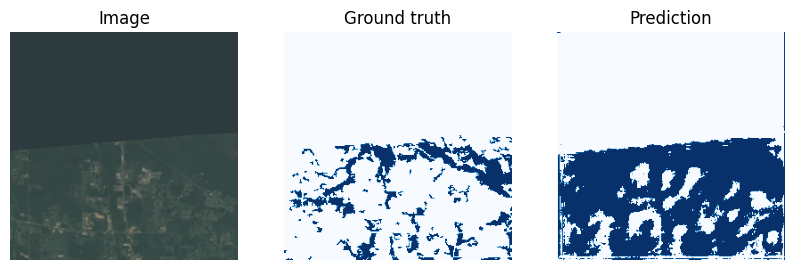

img idx:  1


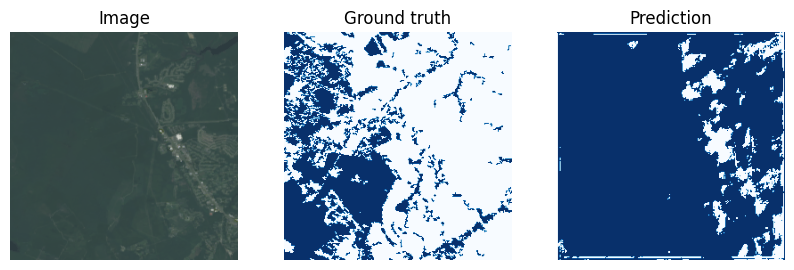

img idx:  2


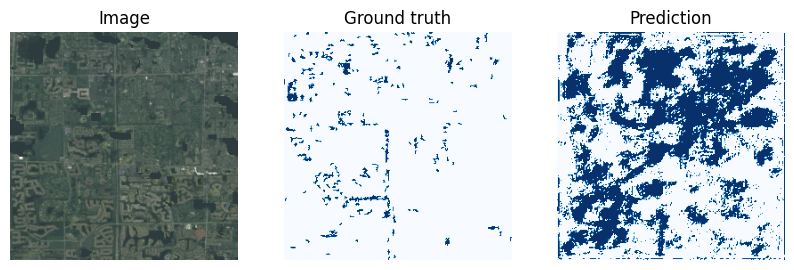

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


img idx:  3


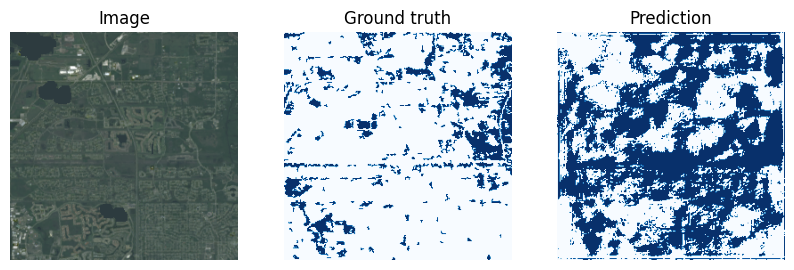

img idx:  4


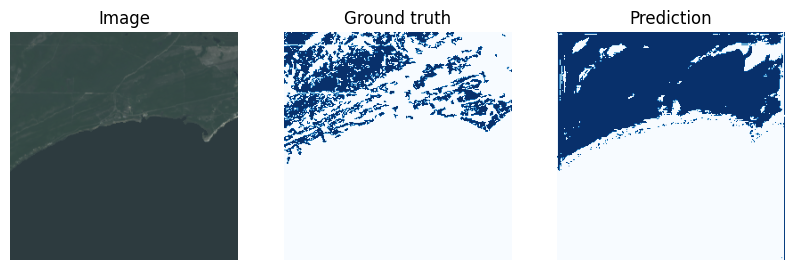

img idx:  5


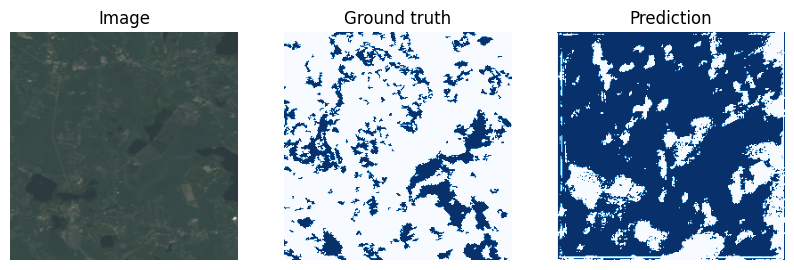

img idx:  6


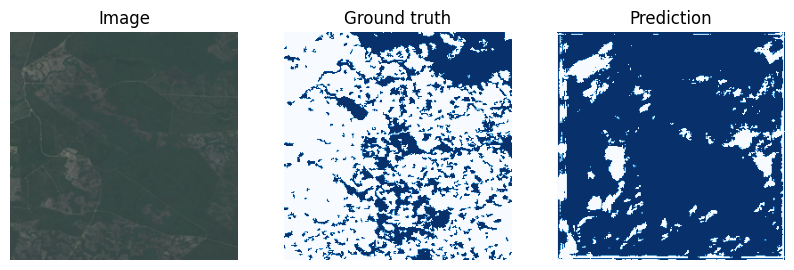

img idx:  7


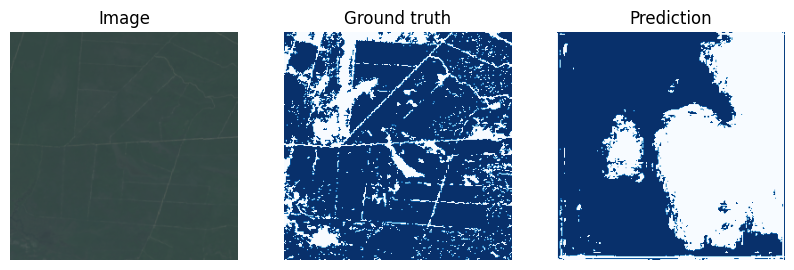

img idx:  8


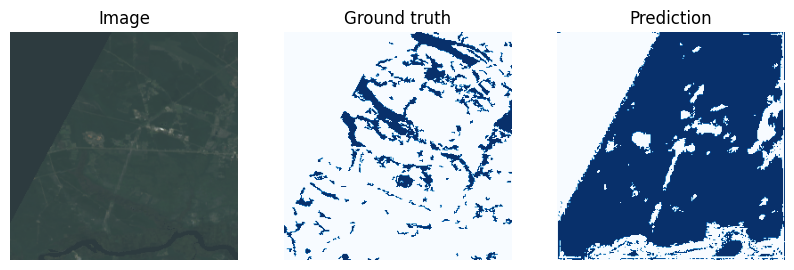

img idx:  9


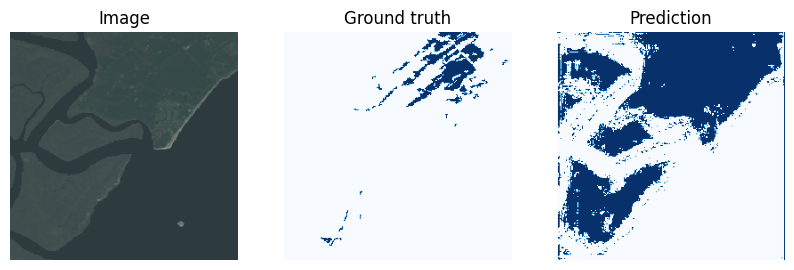

img idx:  10


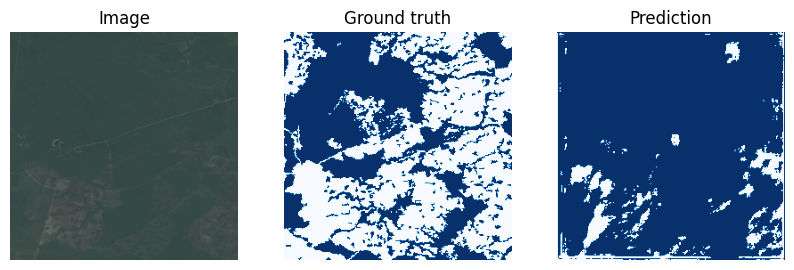

img idx:  11


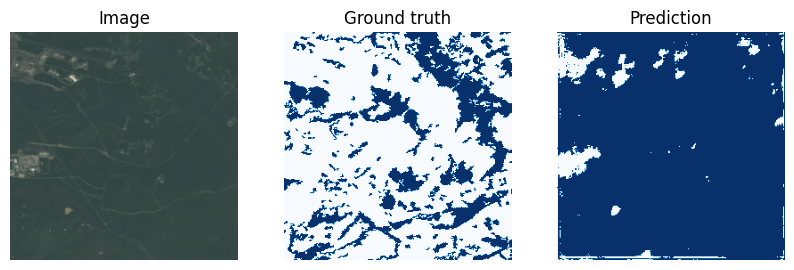

img idx:  12


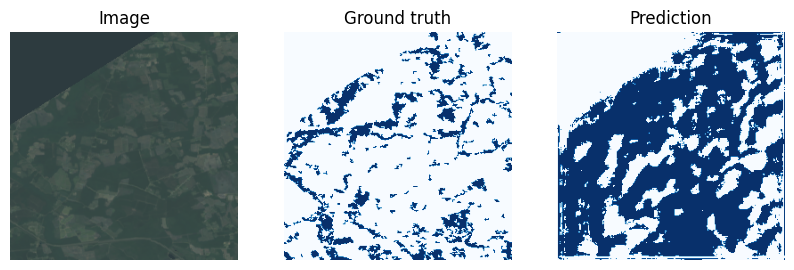

img idx:  13


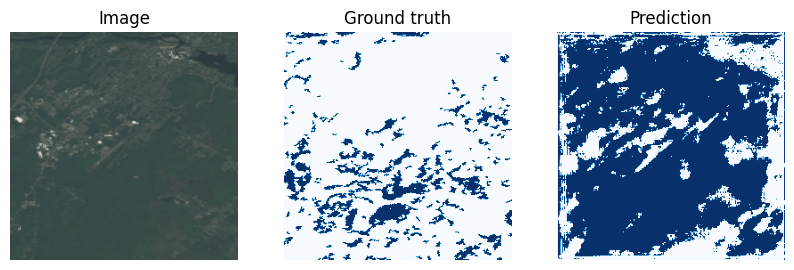

img idx:  14


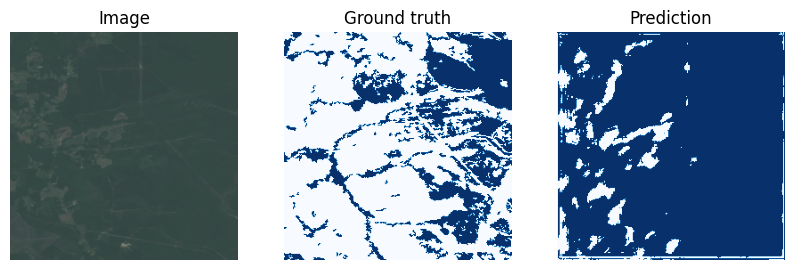

img idx:  15


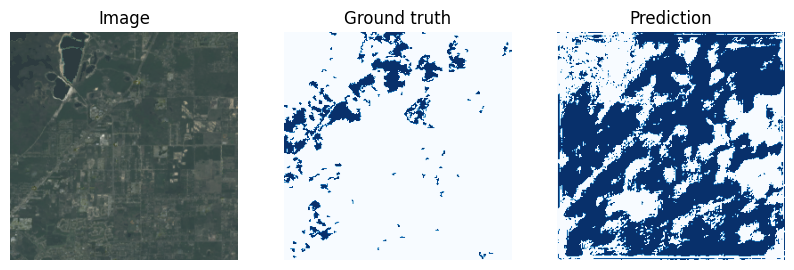

img idx:  16


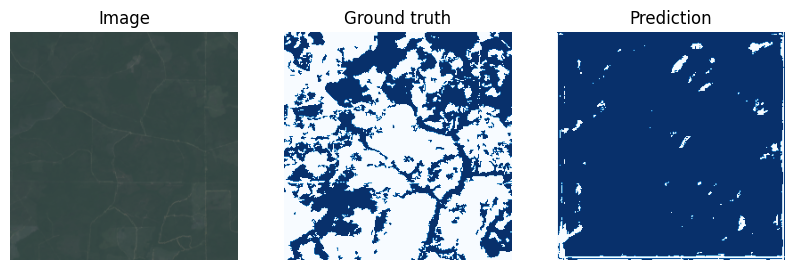

img idx:  17


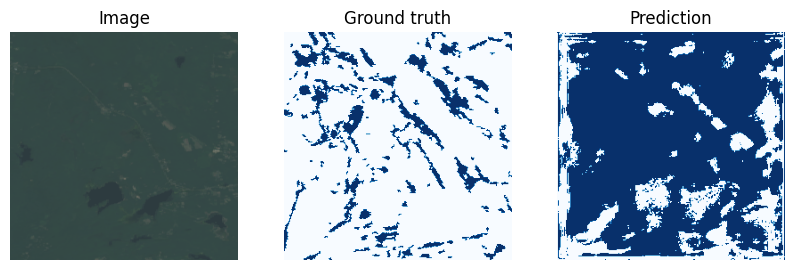

img idx:  18


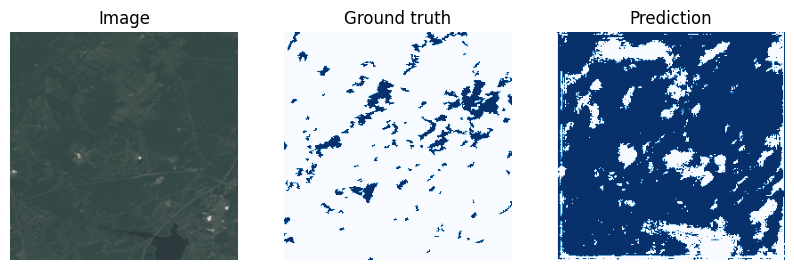

img idx:  19


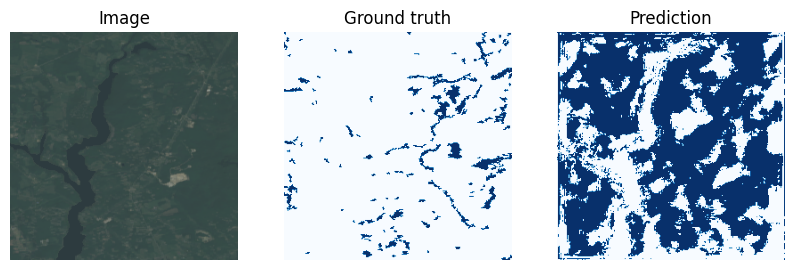

img idx:  20


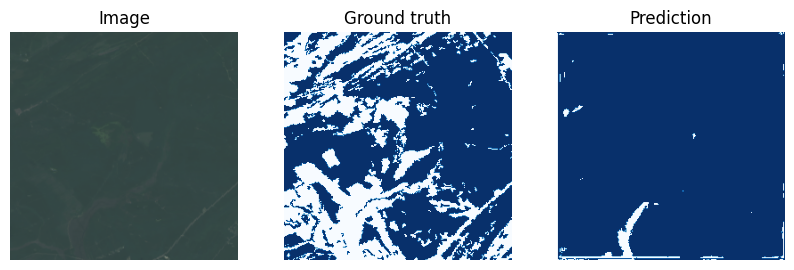

img idx:  21


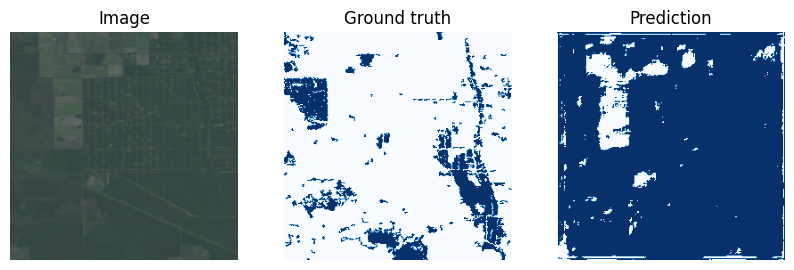

img idx:  22


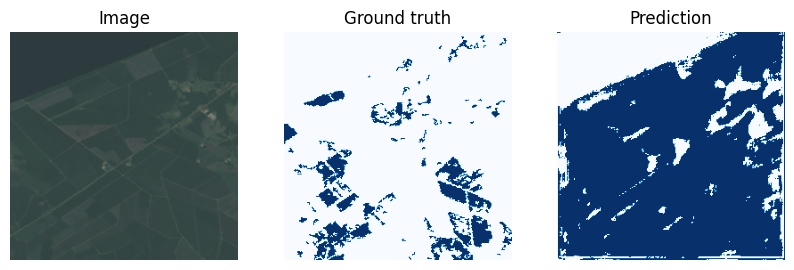

img idx:  23


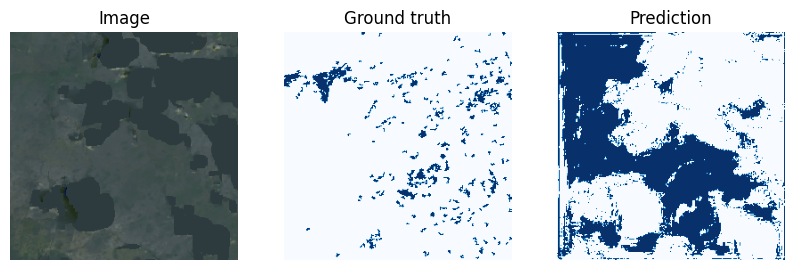

img idx:  24


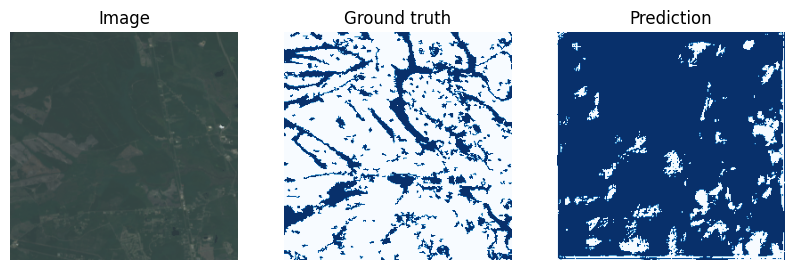

In [38]:
idxs = np.arange(batch_size)
for idx, image, ground_truth_mask, pred_mask in zip(idxs, batch[0], batch[1], pred_masks):
    plt.figure(figsize=(10, 5))
    print("img idx: ", idx)
    
    plt.subplot(1, 3, 1)
    plt.imshow(image[[2,1,0],:,:].numpy().transpose(1, 2, 0)*1.3)  # convert C,H,W -> H,W,C
    plt.title("Image")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(ground_truth_mask.numpy().squeeze(),cmap='Blues') # squeeze classes dim, because we have only one class
    plt.title("Ground truth")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(pred_mask.numpy().squeeze(),cmap="Blues") 
    plt.title("Prediction")
    plt.axis("off")

    plt.show()
     


In [ ]:
##--- Visualization of prediction and fp/fn masks on test_dataset

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/var/tmp/ipykernel_3324/2232307720.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 8))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data (

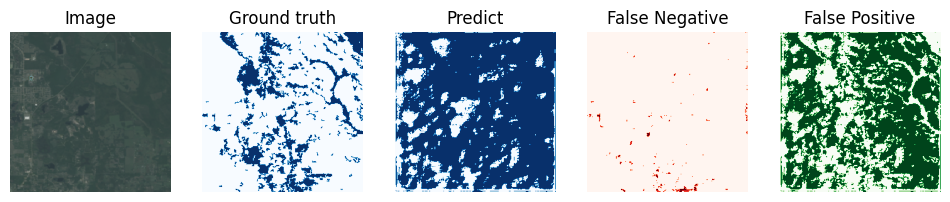

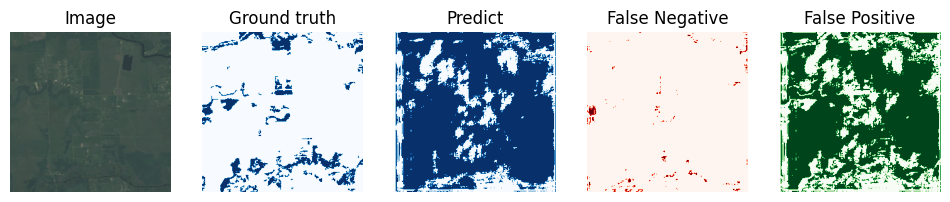

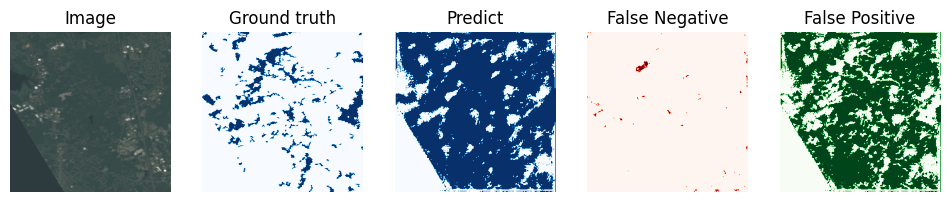

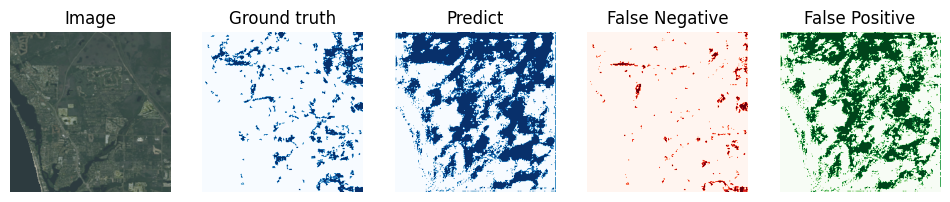

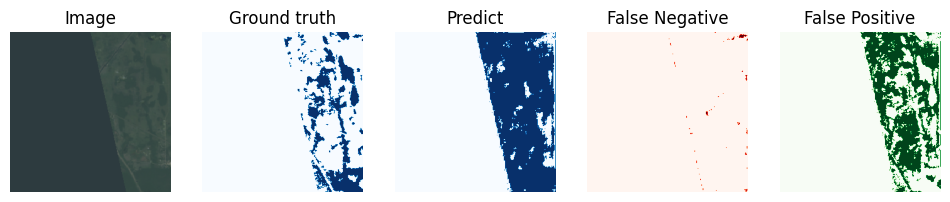

...

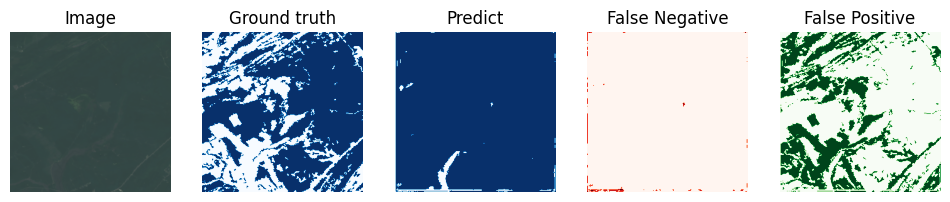

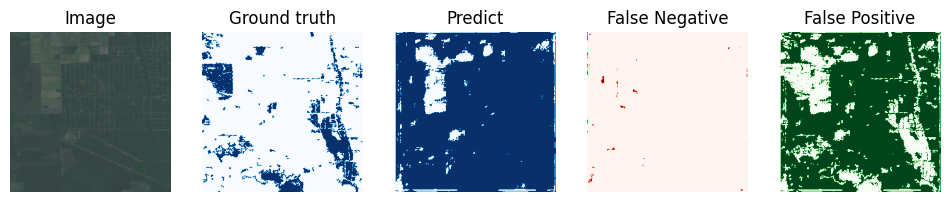

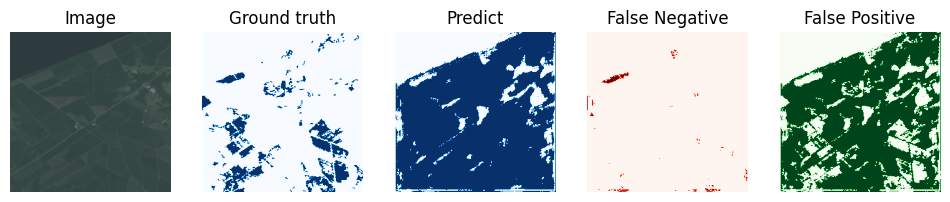

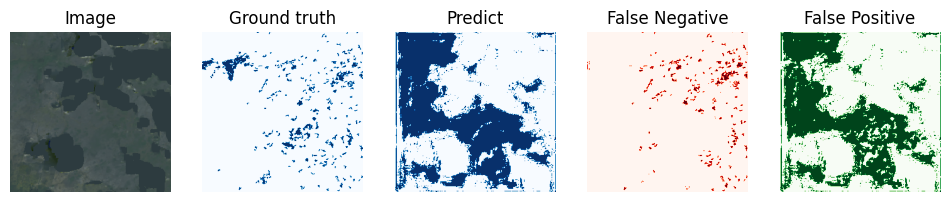

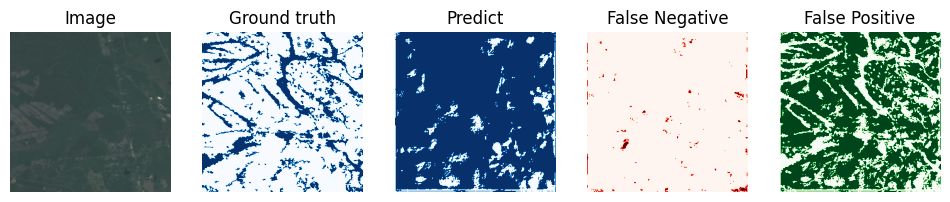

In [37]:
for batch in test_dataloader:
    with torch.no_grad():
        best_model.eval()
        logits = best_model(batch[0])
        pred_probs = logits.sigmoid()
        pred_masks = pred_probs>0.5
        
    idxs = np.arange(1,len(test_dataset)+1)
    for idx, image, gt, pred in zip(idxs, batch[0], batch[1], pred_masks):
    
        plt.figure(figsize=(12, 8))
        #print("img ", idx)
    
        gt = gt.numpy().squeeze()
        pred = pred.numpy().squeeze()
        fp = get_fp_mask(gt,pred)
        fn = get_fn_mask(gt,pred)
        
        plt.subplot(1,5, 1)
        plt.imshow(image[[2,1,0],:,:].numpy().transpose(1, 2, 0)*1.3)  # convert C,H,W -> H,W,C
        plt.title("Image")
        plt.axis("off")

        plt.subplot(1, 5, 2)
        plt.imshow(gt,cmap='Blues') # squeeze classes dim, because we have only one class
        plt.title("Ground truth")
        plt.axis("off")

        plt.subplot(1, 5, 3)
        plt.imshow(pred,cmap='Blues') 
        plt.title("Predict")
        plt.axis("off")
        
        plt.subplot(1, 5, 4)
        plt.imshow(fn,cmap='Reds') 
        plt.title("False Negative")
        plt.axis("off")

        plt.subplot(1, 5, 5)
        plt.imshow(fp,cmap='Greens') 
        plt.title("False Positive")
        plt.axis("off")

